# Adaptive mean filter:

the adaptive mean filter just like the adaptive median filter, is a spatial filter designed to reduce noise while preserving edges and other significant details in an image. Unlike a standard filters, which uses a fixed-size window, the adaptive median filter adjusts the window size based on local image statistics.

it folows the same steps as the adaptive median filter

1.   start with an initial window/kernel size, and define a maximum window size.
2.   calculate the the needed the minimum and maximum values, and any needed other statistics, but this time instead of finding the kernel's median, the mean is found.

3. follow the same choise rules to choose the pixel new values:


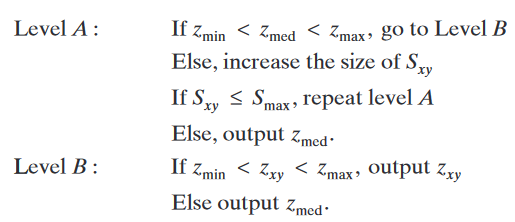

In [ ]:
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import time
import numpy as np
import numpy as np
from scipy.ndimage import generic_filter
import numpy as np
from scipy.ndimage import convolve, median_filter

In [ ]:
!pip install scipy

In [ ]:
def adaptive_mean_filter(img, kernel_size, max_kernel_size=7):
    filtered_img = np.copy(img)

    for cur_size in range(kernel_size, max_kernel_size + 1, 2):
        local_region = median_filter(img[:, :], size=cur_size, mode='reflect')

        z_min = np.min(local_region)
        z_max = np.max(local_region)
        z_med = np.mean(local_region)

        if z_min < z_med < z_max:
            filtered_img[:, :] = np.where(
                (img[:, :] < z_min) | (img[:, :] > z_max), z_med, img[:, :]
            )
            break
        else:
            continue
    else:
        filtered_img[:, :] = z_med

    return filtered_img


In [ ]:

image_folder = '/content/original_images'

data = []

for filename in os.listdir(image_folder):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        img = cv2.imread(os.path.join(image_folder, filename))
        if img is not None:
            # Convert to grayscale
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            data.append({'filename': filename, 'image': gray_img})

original = pd.DataFrame(data)

In [ ]:
Computational_times = {}
average_MSE = {}
average_psnr = {}

# Salt and Pepper noise:

In [ ]:
def add_salt_pepper_noise(image, prob):
    noisy_image = image.copy()

    num_salt = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 1

    num_pepper = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 0

    return noisy_image

noise_levels = [0.01, 0.08, 0.2]

noisy_data = []

for index, row in original.iterrows():
    for level in noise_levels:
        noisy_img = add_salt_pepper_noise(row['image'], level)
        noisy_data.append({
            'filename': f"{row['filename']}_noise_{level}",
            'image': noisy_img,
            'noise_level': level
        })


salty = pd.DataFrame(noisy_data)

In [ ]:
Computational_times["Salt and Pepper"] = []
average_MSE["Salt and Pepper"] = []
average_psnr["Salt and Pepper"] = []

In [ ]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = adaptive_mean_filter(row['image'], kernel_size=5,max_kernel_size=7)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 0.8483 seconds


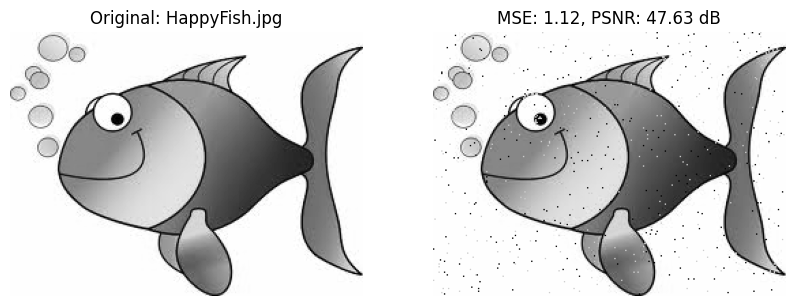

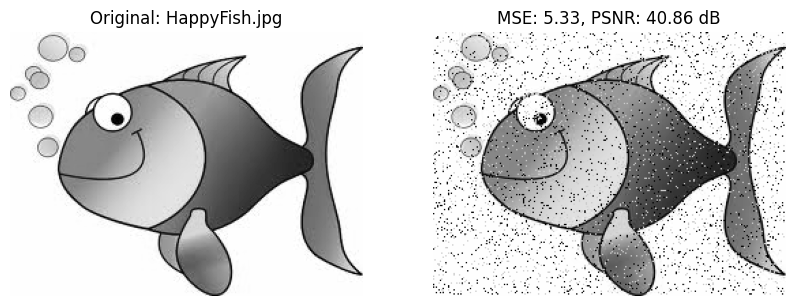

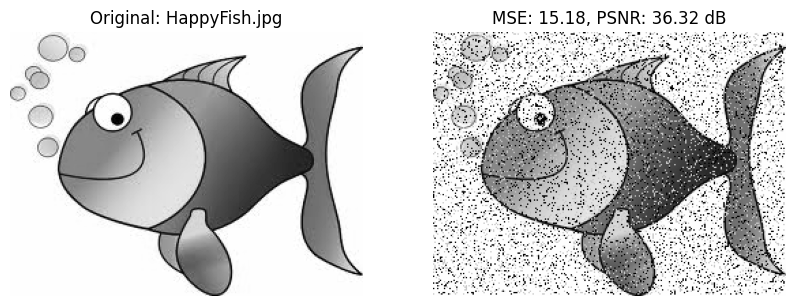

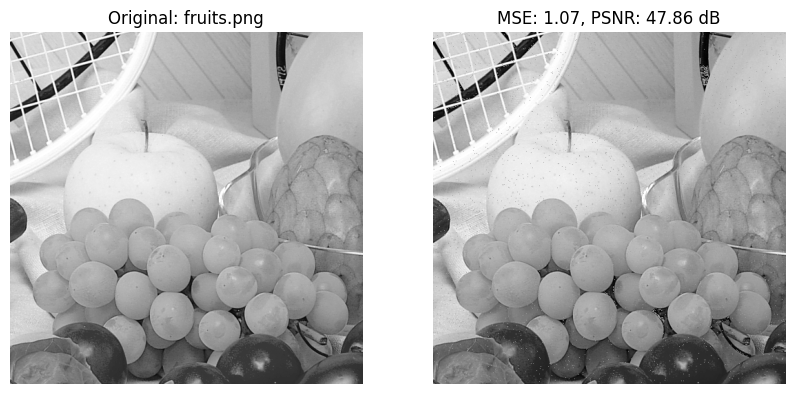

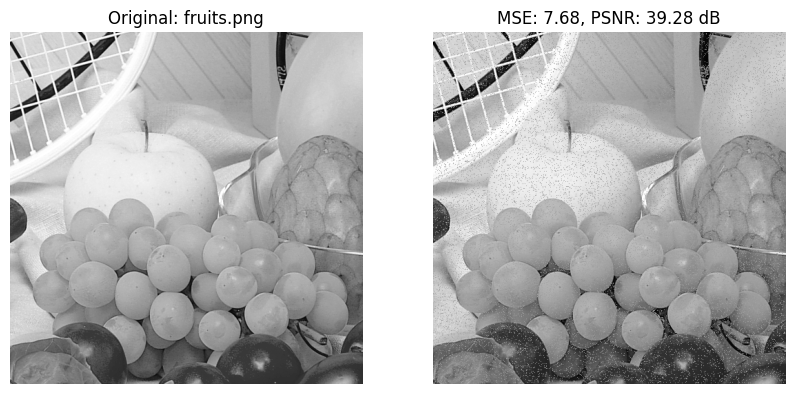

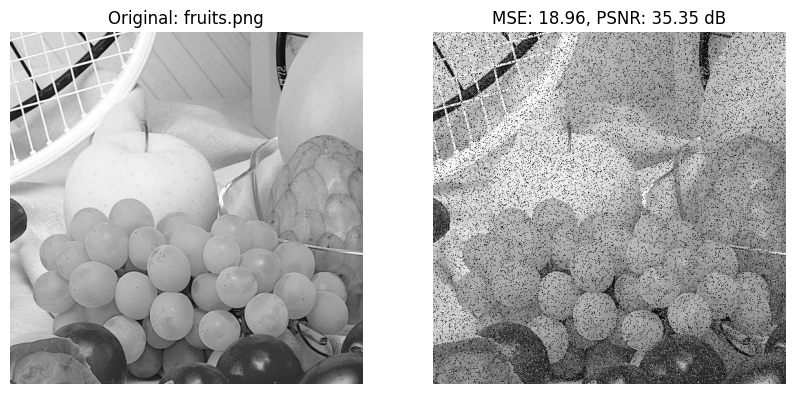

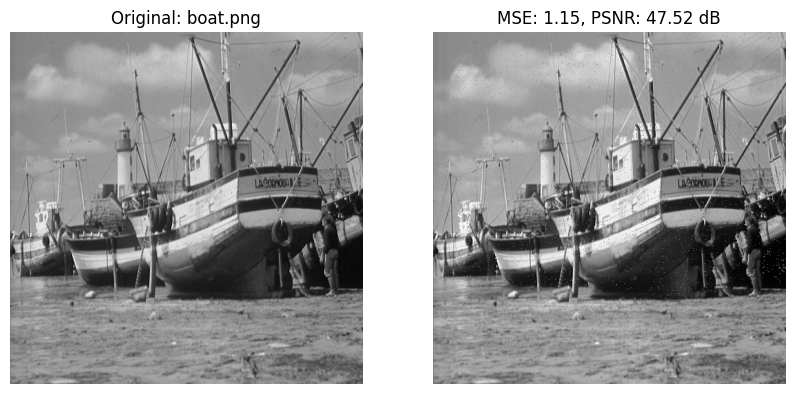

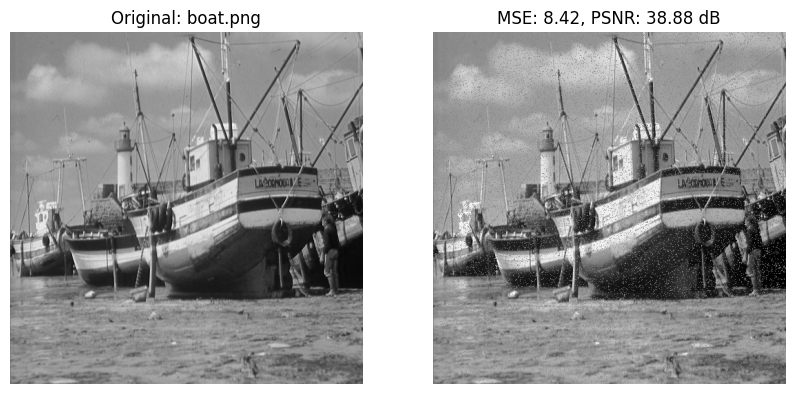

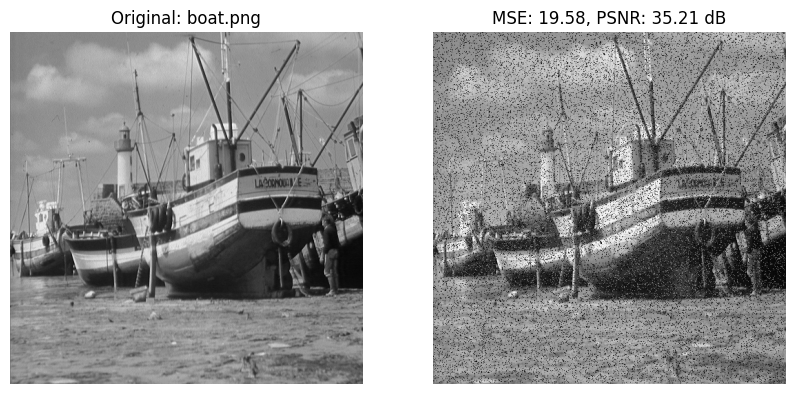

avarage mse = 8.721477177008897
avarage psnr = 40.98945972926962


In [ ]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

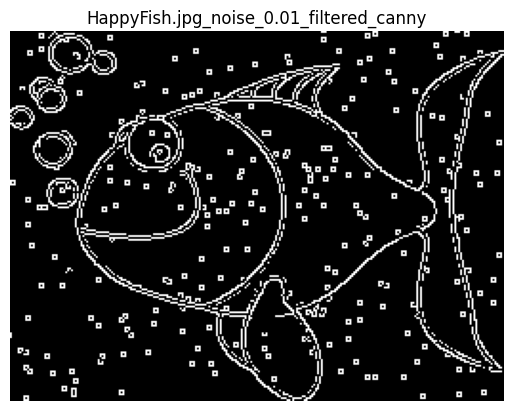

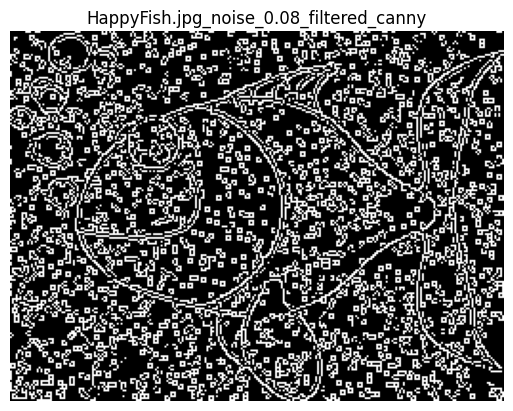

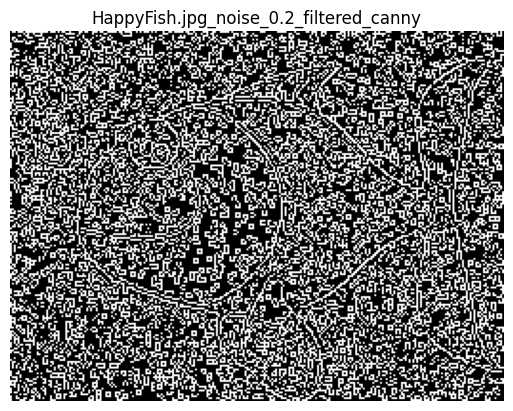

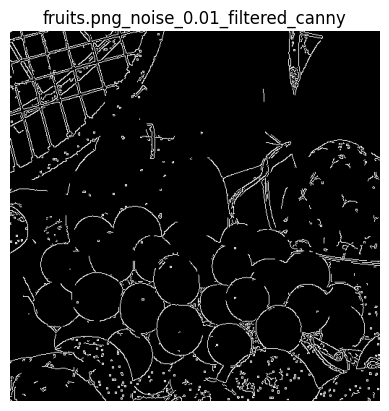

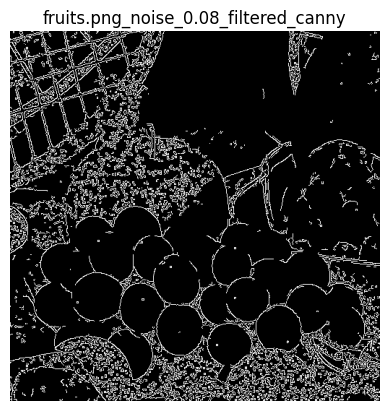

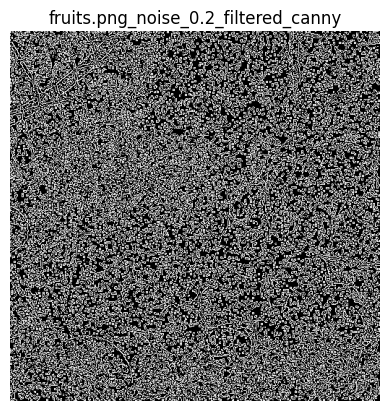

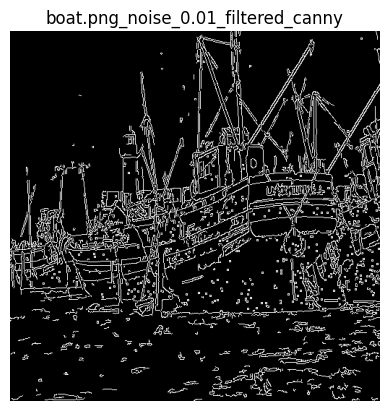

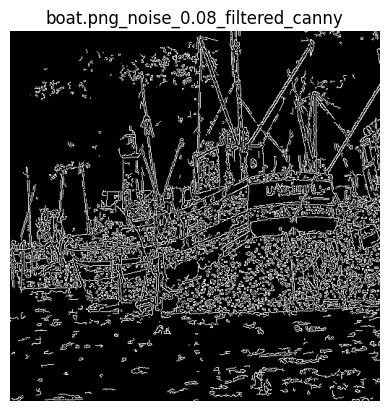

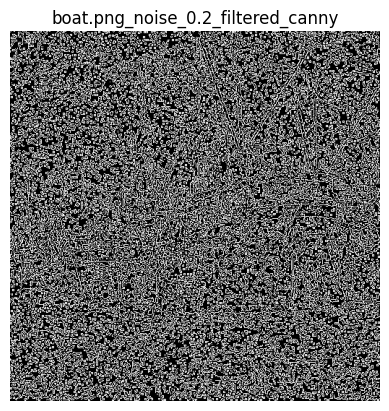

In [ ]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

As seen the adaptive mean filter gets rid of most of the noise in images with low to medium levels of noise, while not damaging the edges. Still, as the adaptive mean filter is built on the mean filter, in images with a lot of noise, the mean tends to get skewed toward the noise, instead of the correct pixels.




Yet, even with noisy images that still suffer from noise getting detected in them as edges, the objects' skeleton edges stay unharmed, as the filter don't weaken them. As seen in images with medium levels of noise.




However, the filter isn't perfect for all cases, as very high levels of noise mess with the filter, tricking it to think that the noise is details that must be preserved. That's why in images with high levels of noise we see Canny not being able to detect a clear skeleton of the image object, but detecting the noisy image as noisy edges without meaning.

In [ ]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = adaptive_mean_filter(row['image'], kernel_size=11,max_kernel_size=15)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 3.2368 seconds


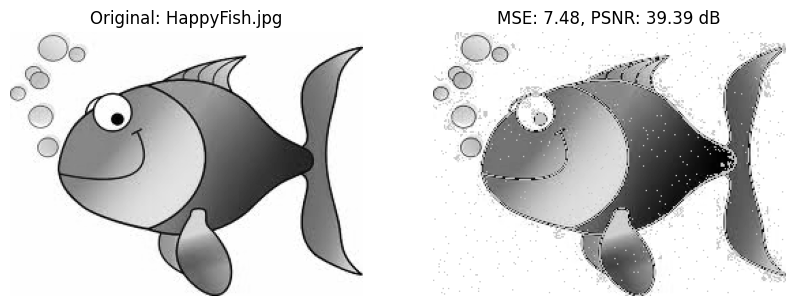

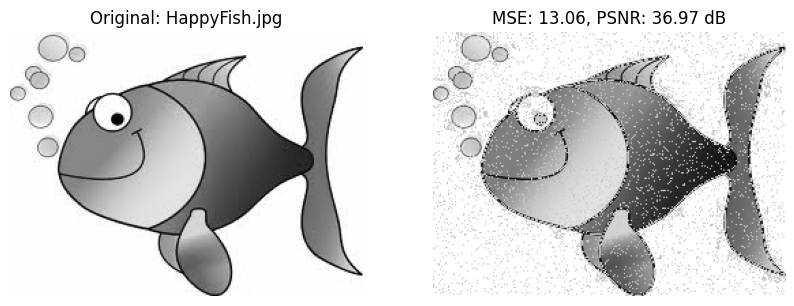

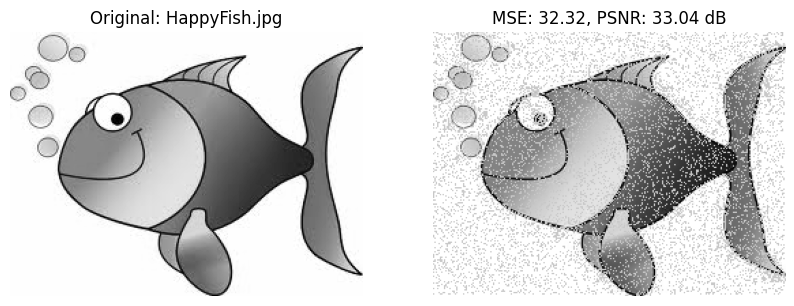

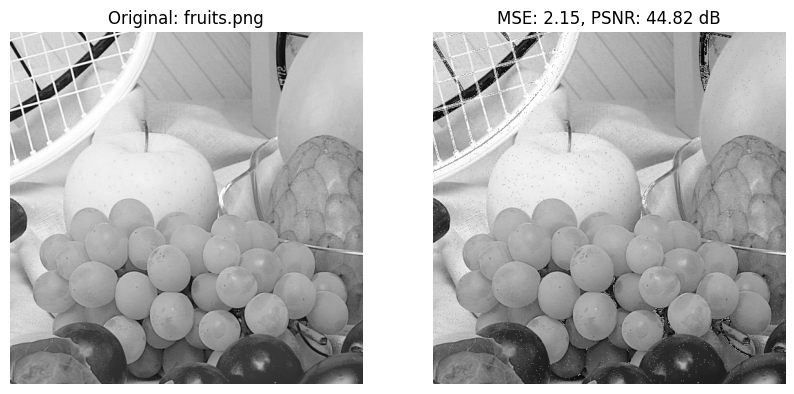

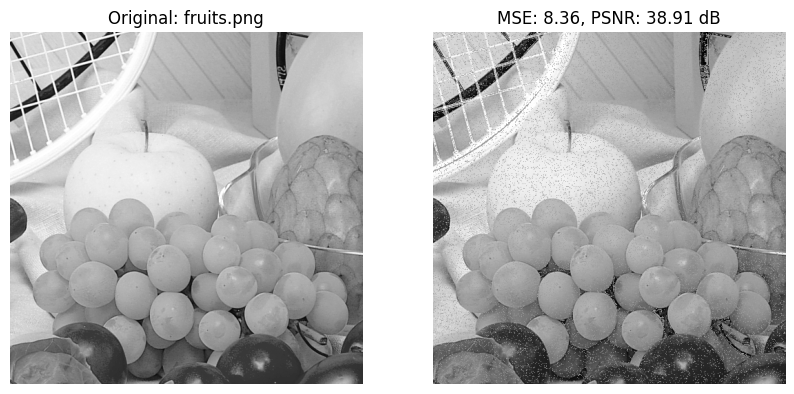

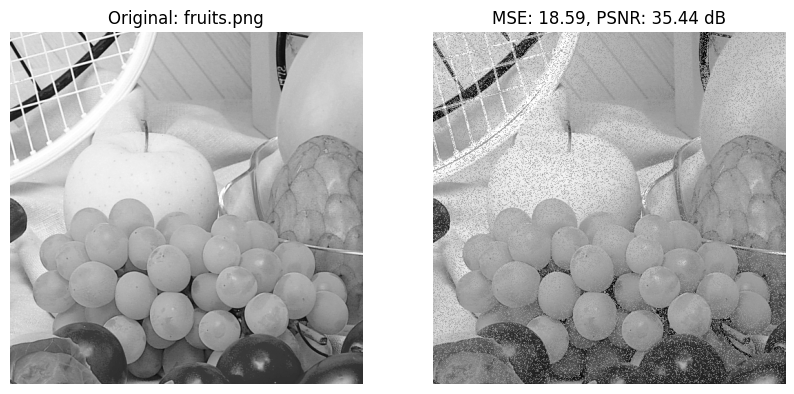

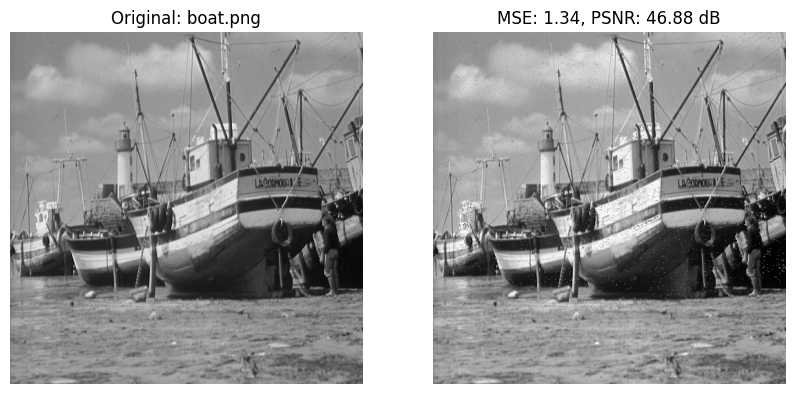

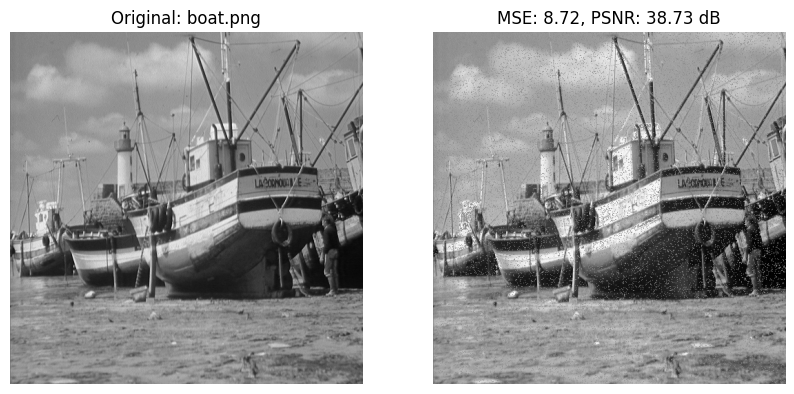

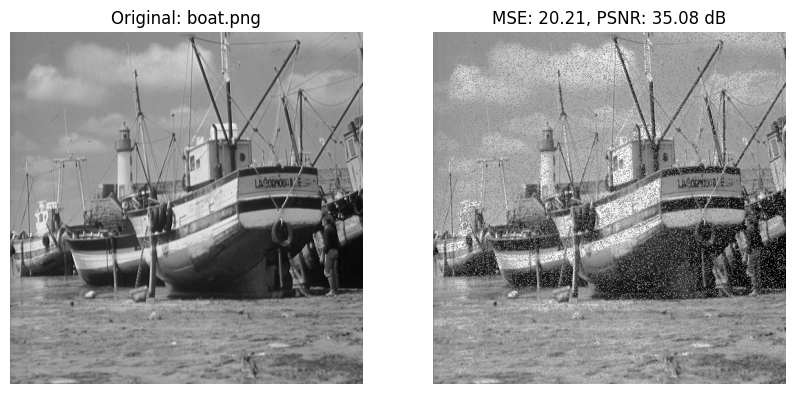

avarage mse = 12.468460972761356
avarage psnr = 38.804350822803855


In [ ]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

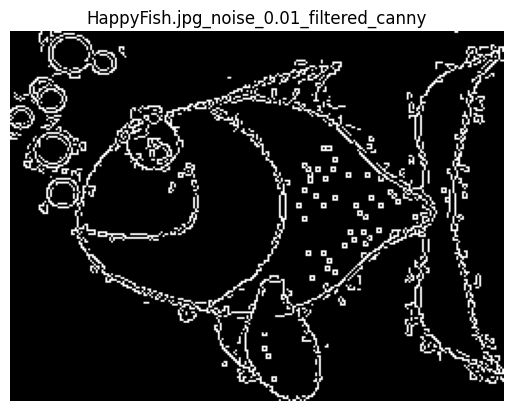

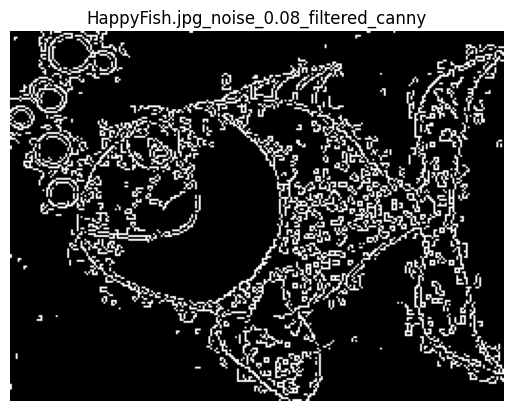

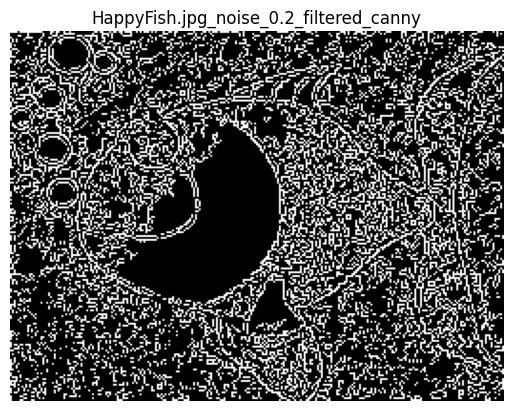

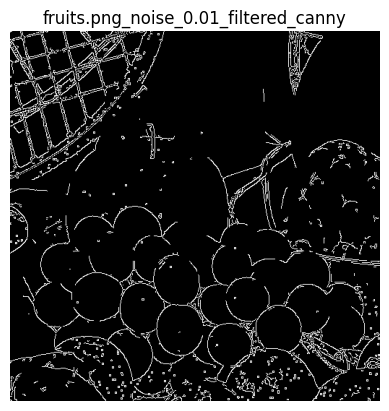

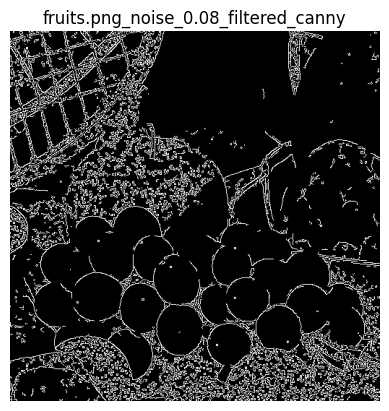

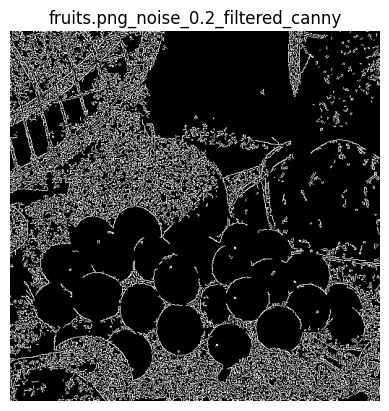

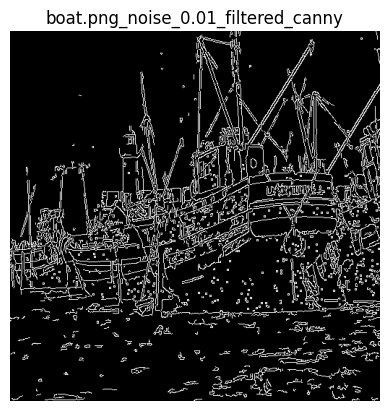

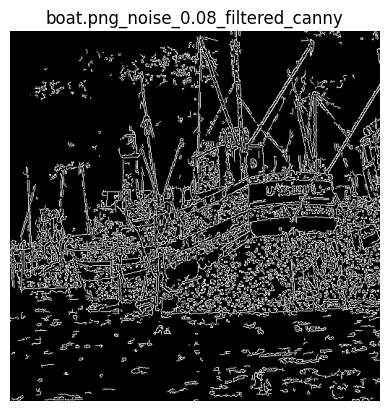

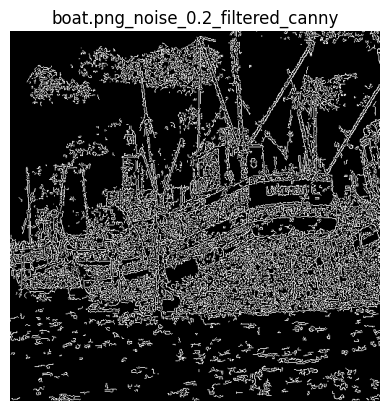

In [ ]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

With a larger initial kernel, and a larger maximum kernel size, the filter was given more freedom to work with the images' needs. Now the filter increases the kernel size, so it has a higher probability of containing undamaged pixels instead of errors, skewing the mean back to normal values. This allows the filter to deal with images with high levels of noise better.




As seen in Canny's output, these images do not look like noise without meaning any more, but an object skeleton could be distinguished, although noisy, but the strong edges that separated the objects/background in the image stayed strong enough to be detected by Canny.




That's all because the filters blurring/smoothing was increased as the kernel increased, yet that unlike the normal mean filter, didn't lead the adaptive mean filter to blur the edges too much that they no longer detected, as it made sure to preserve the edges. This however have the side-effect of preserving noise too close around the images edges/details.

# Gaussian noise:

In [ ]:
def add_gaussian_noise(image, var, mean=20):
    sigma = var**0.5
    gaussian_noise = np.random.normal(mean, sigma, image.shape)

    noisy_image = image + gaussian_noise

    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)

    return noisy_image

gaussian_variances = [50, 100, 200]

noisy_data_gaussian = []

for index, row in original.iterrows():
    for var in gaussian_variances:
        noisy_img = add_gaussian_noise(row['image'], var=var)
        noisy_data_gaussian.append({
            'filename': f"{row['filename']}_gaussian_{var}",
            'image': noisy_img,
            'variance': var
        })

gaussian_noise = pd.DataFrame(noisy_data_gaussian)

In [ ]:
Computational_times["Gaussian"] = []
average_MSE["Gaussian"] = []
average_psnr["Gaussian"] = []

In [ ]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = adaptive_mean_filter(row['image'], kernel_size=5, max_kernel_size=7)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 1.1282 seconds


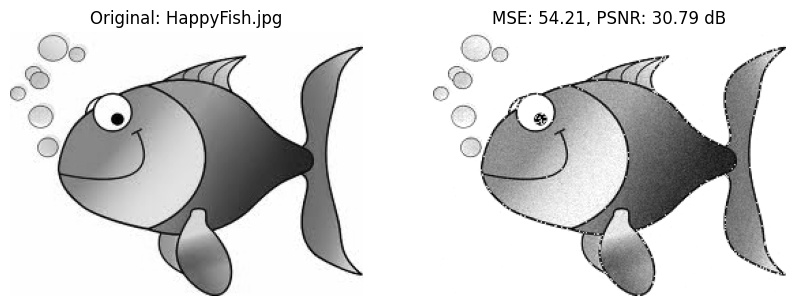

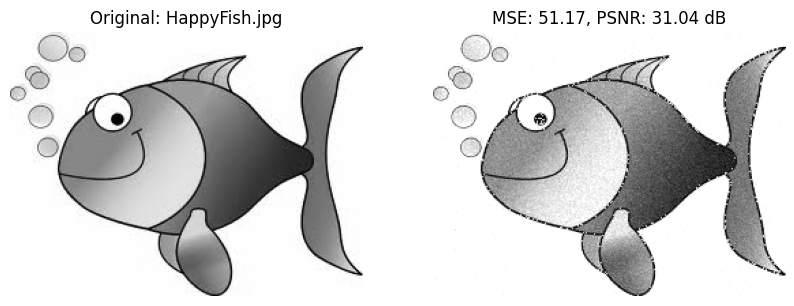

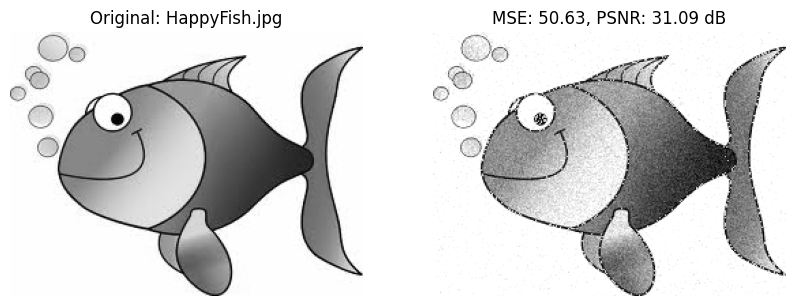

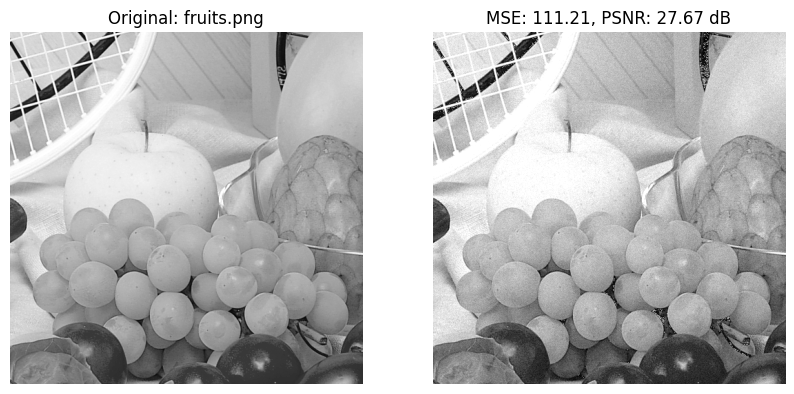

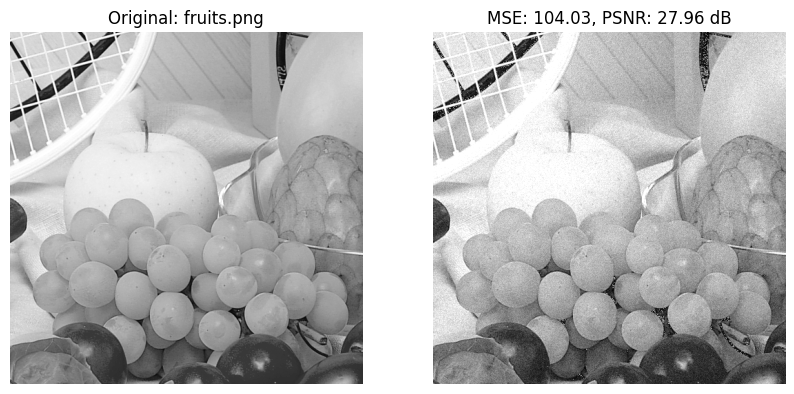

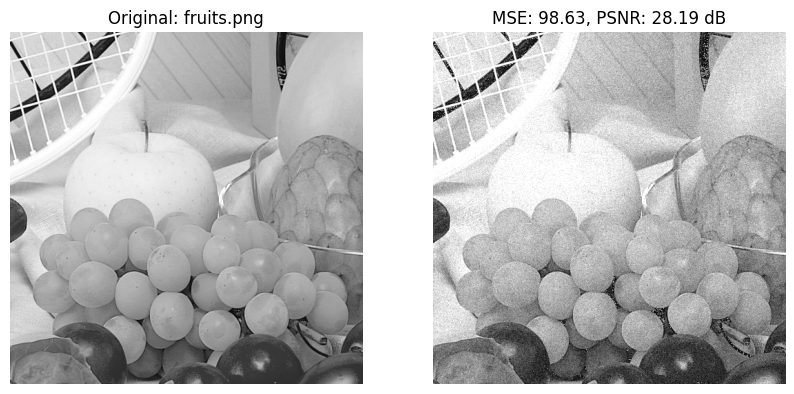

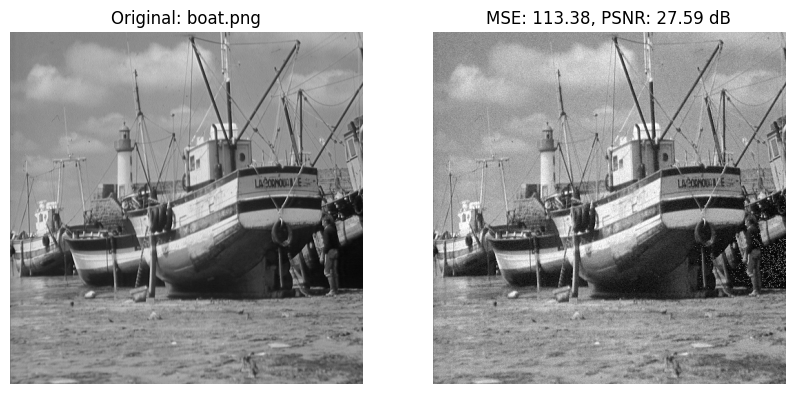

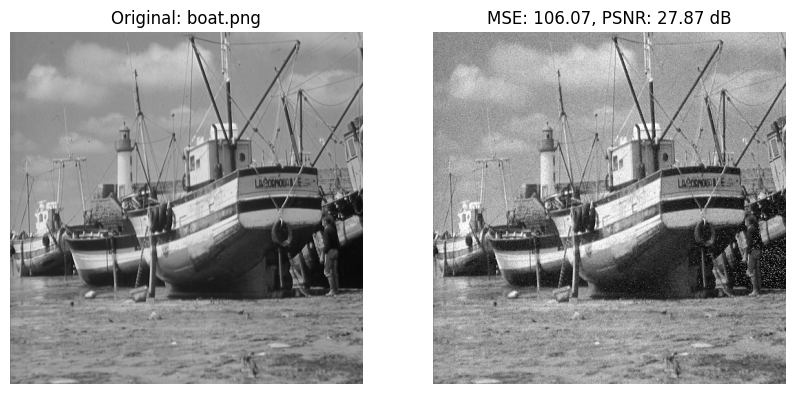

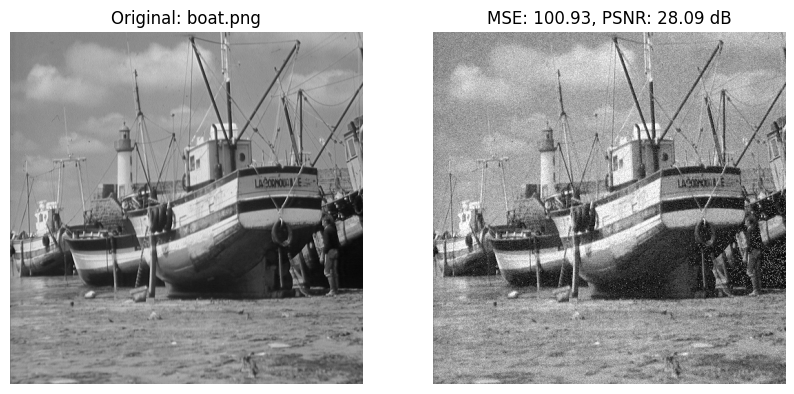

avarage mse = 87.80665912641754
avarage psnr = 28.920822503937828


In [ ]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

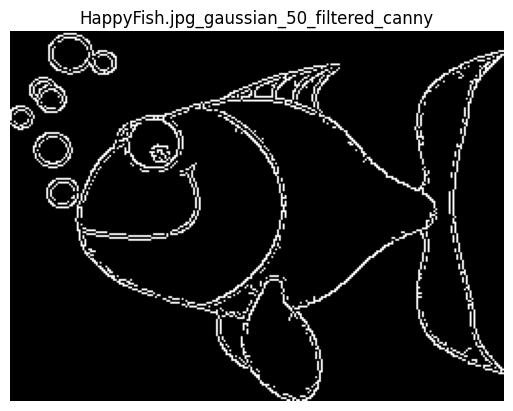

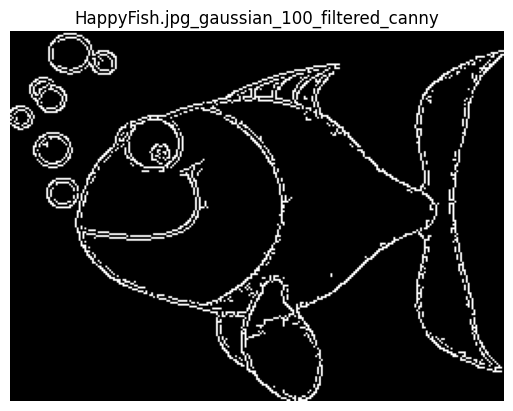

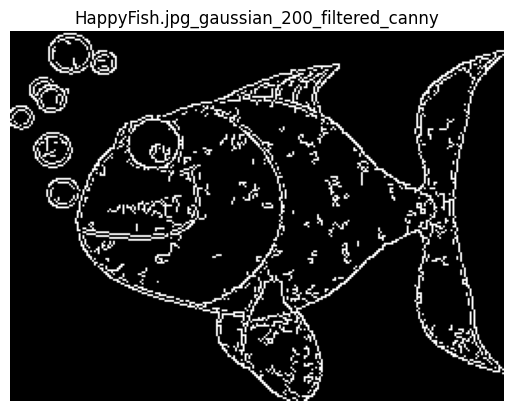

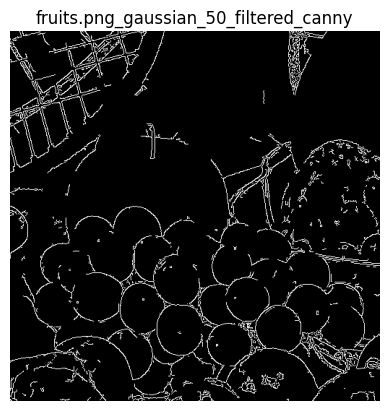

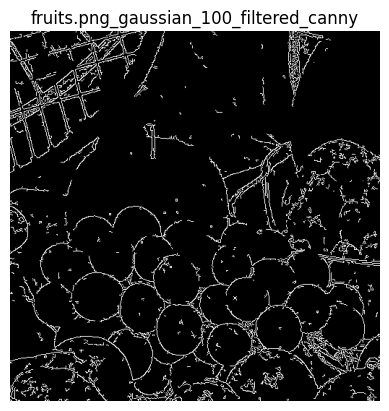

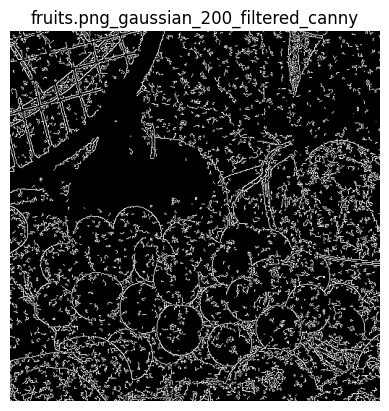

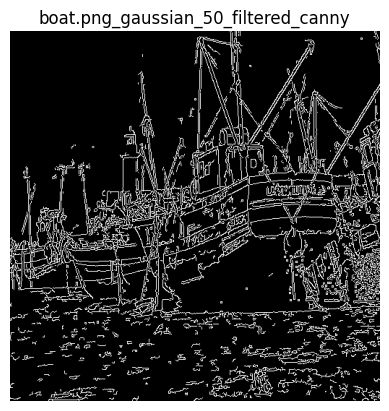

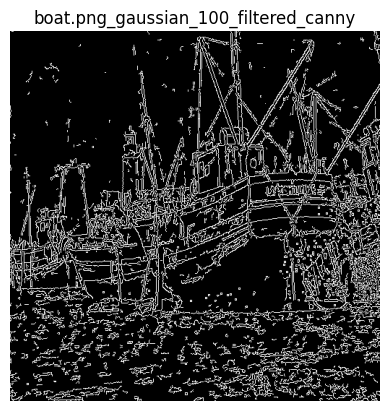

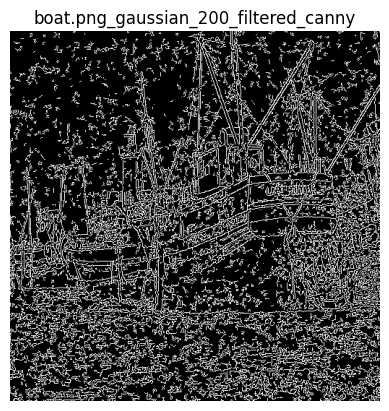

In [ ]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Same as before the filter got rid of the noise as best as it could without damaging the edges. Preserving the images' details. But with a small kernel, it's easy for the filter to get confused, and assume that the high level of noise inside its kernel is details that must not be replaced with the mean.

In [ ]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = adaptive_mean_filter(row['image'], kernel_size=11, max_kernel_size=15)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 3.6454 seconds


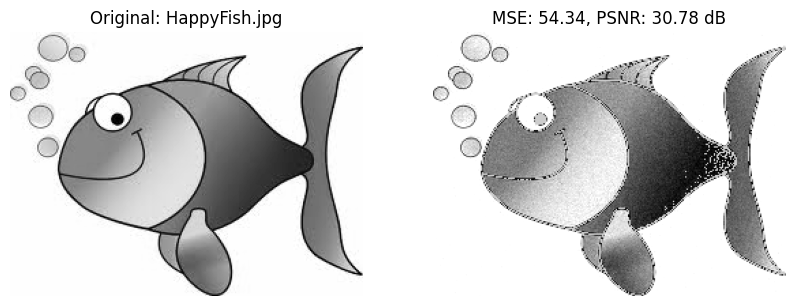

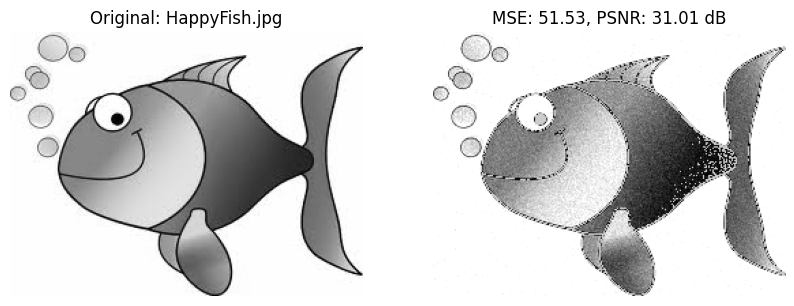

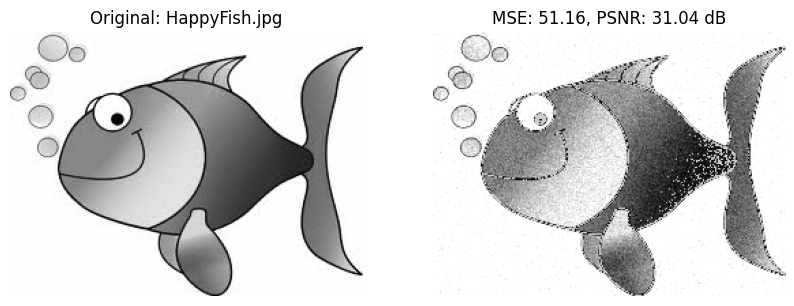

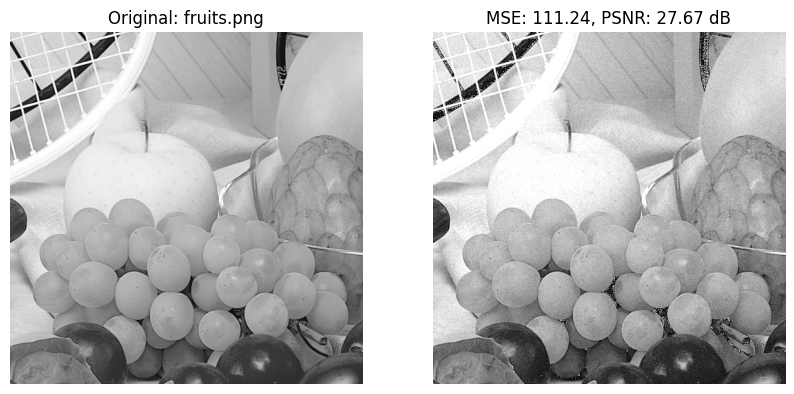

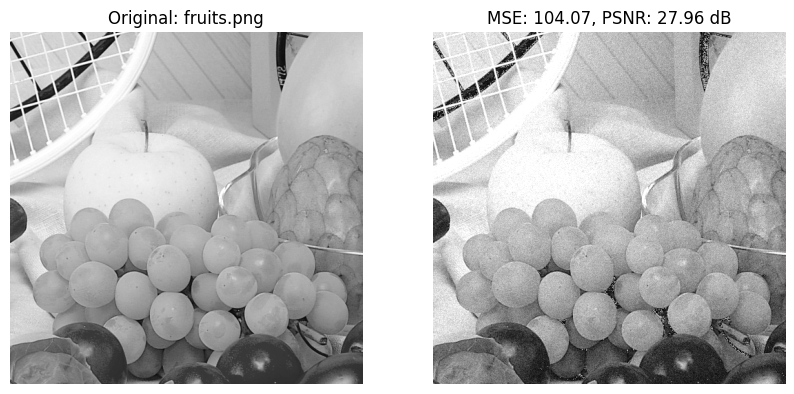

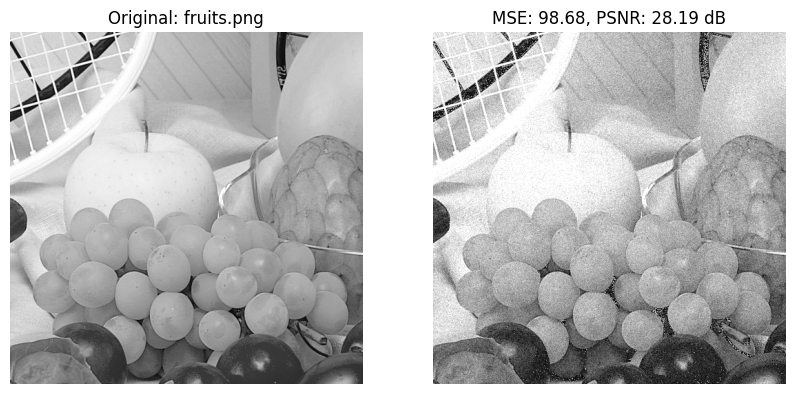

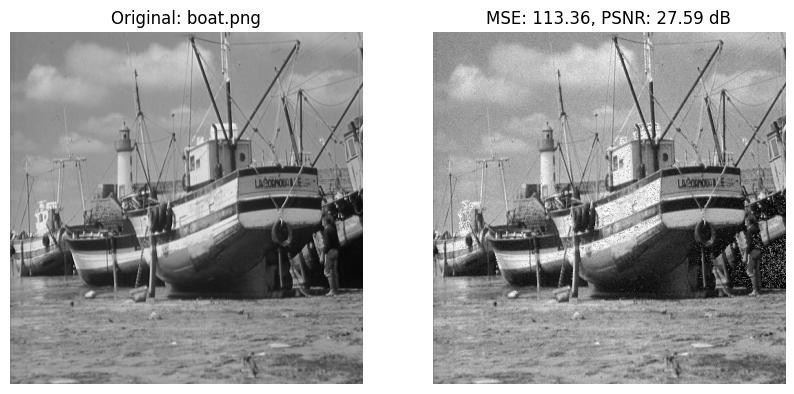

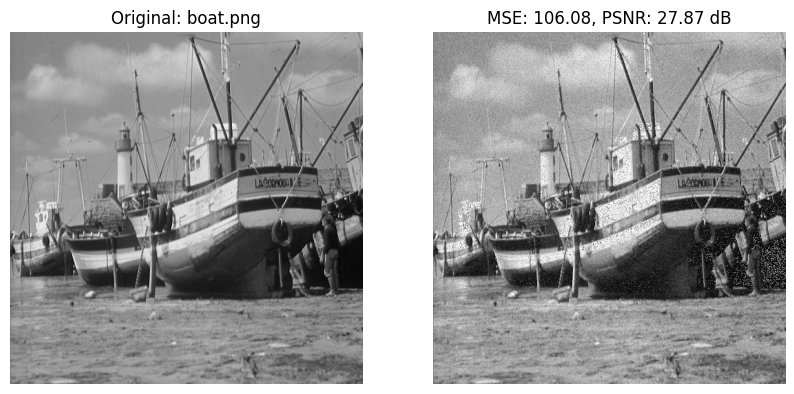

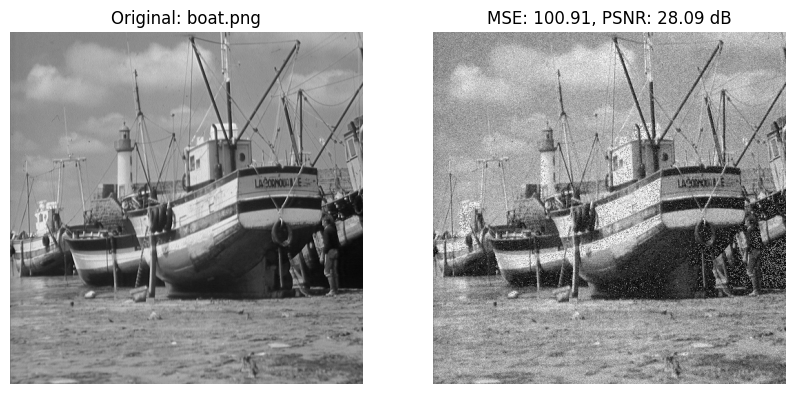

avarage mse = 87.93061656171021
avarage psnr = 28.910821171407267


In [ ]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

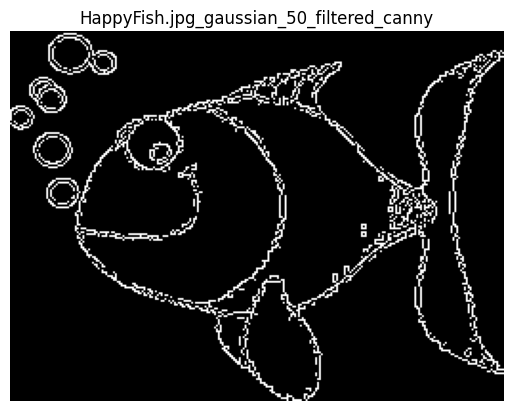

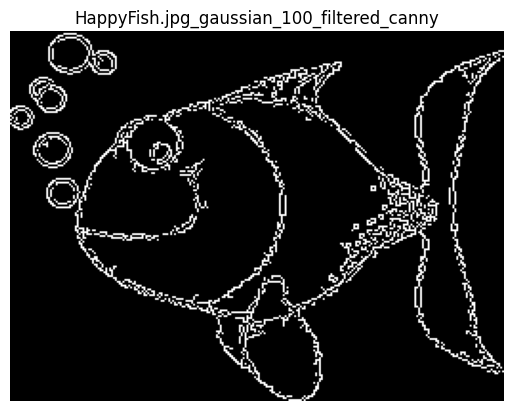

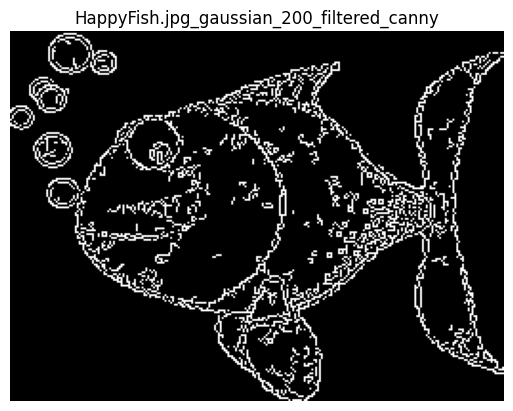

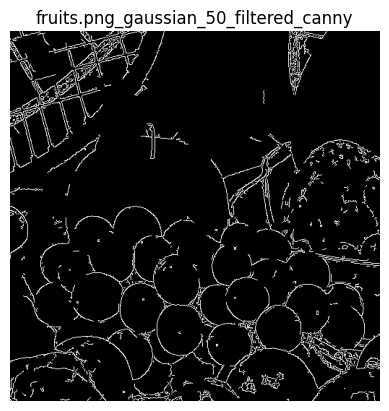

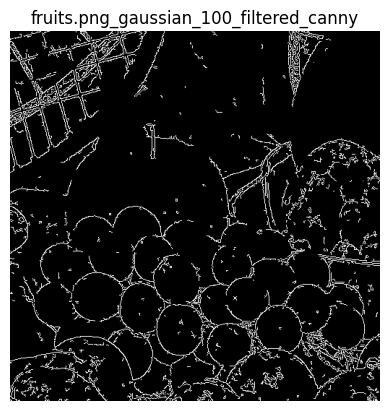

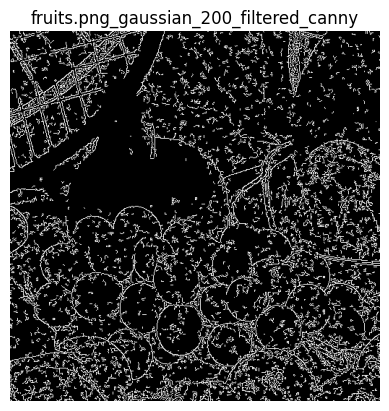

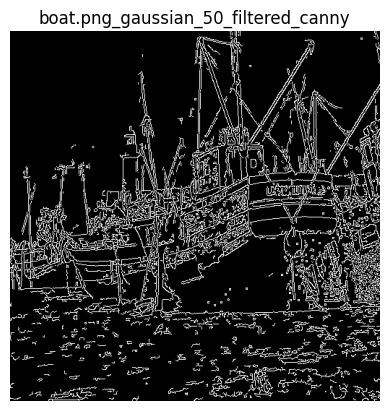

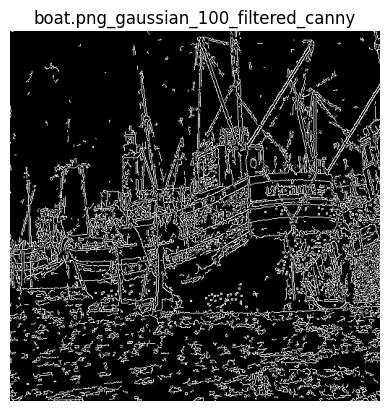

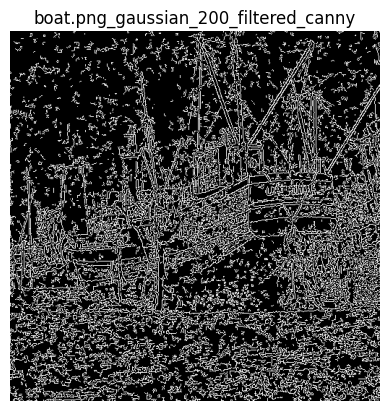

In [ ]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

With a larger kernel/s, the filter did better in removing the noise from the images, in low detailed images. With more details/edges in the images more noise is kept in the image, as there's more details the filter keeps the same, with the noise around them.

# Poisson Noise:

In [ ]:
def add_poisson_noise(image):
    noisy_image = np.random.poisson(image).astype(np.uint8)
    noisy_image = np.clip(noisy_image, 0, 255)
    return noisy_image

noisy_data_poisson = []

for index, row in original.iterrows():
    noisy_img = add_poisson_noise(row['image'])
    noisy_data_poisson.append({
        'filename': f"{row['filename']}_poisson",
        'image': noisy_img,
        'noise_type': 'poisson'
    })

noisy_poisson = pd.DataFrame(noisy_data_poisson)

In [ ]:
Computational_times["Poisson"] = []
average_MSE["Poisson"] = []
average_psnr["Poisson"] = []

In [ ]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = adaptive_mean_filter(row['image'], kernel_size=5, max_kernel_size=7)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 0.3983 seconds


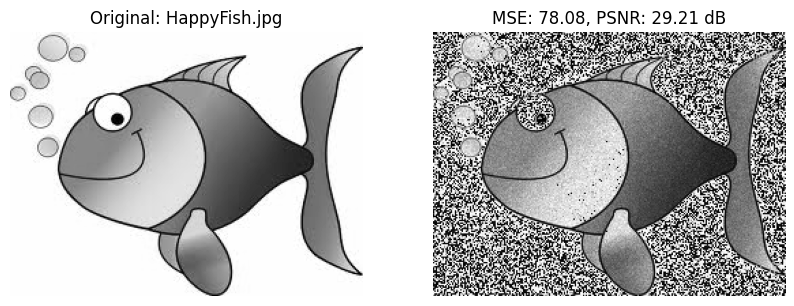

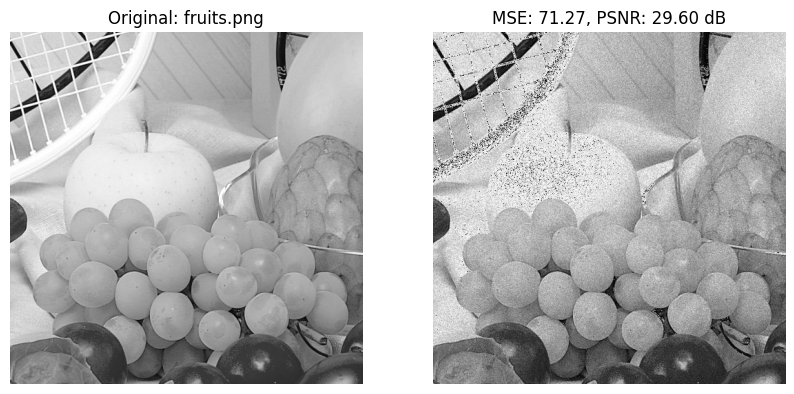

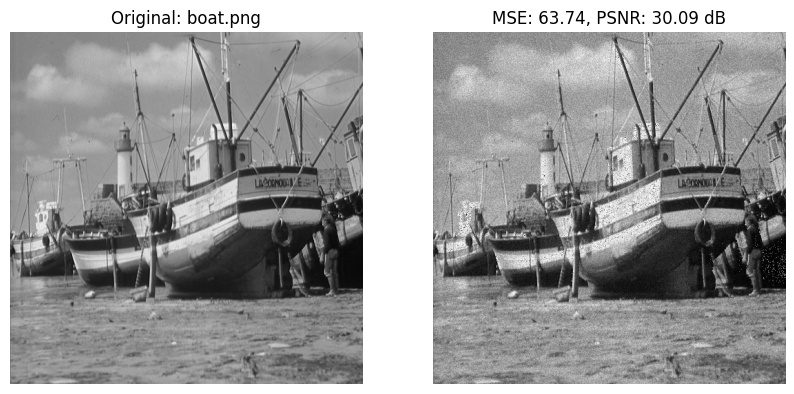

avarage mse = 71.02861495751206
avarage psnr = 29.631367604553972


In [ ]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

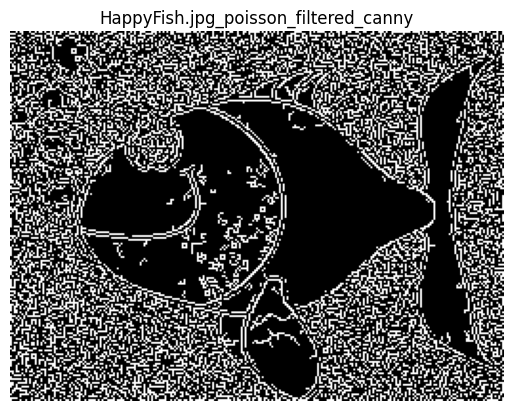

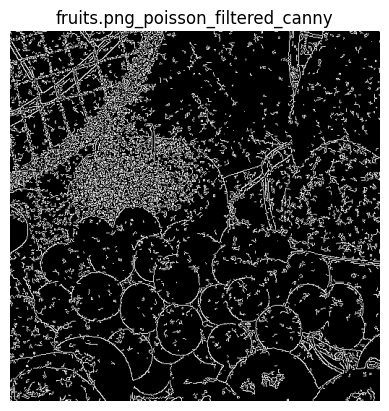

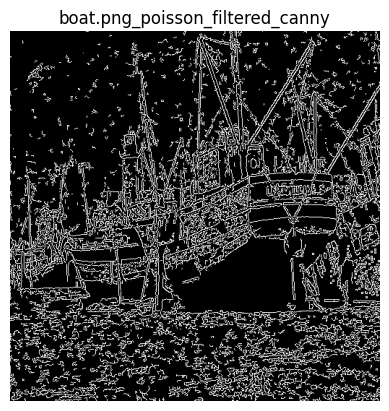

In [ ]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Although the adaptive filters were made to smooth the noise, while preserving the edges, it can't preserve edges that were damaged by the noise itself.

As we saw in the previous outputs, with the fish's eye, and the apple.

In [ ]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = adaptive_mean_filter(row['image'], kernel_size=11, max_kernel_size=15)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 1.1836 seconds


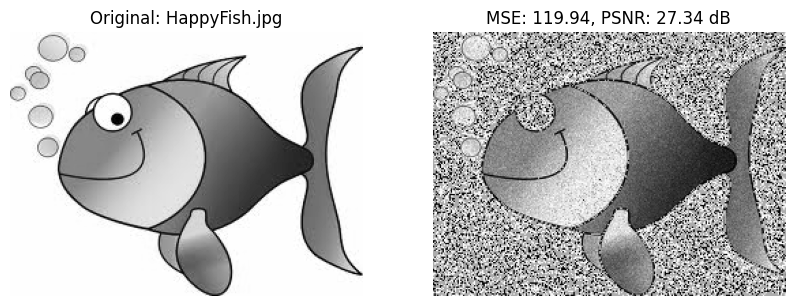

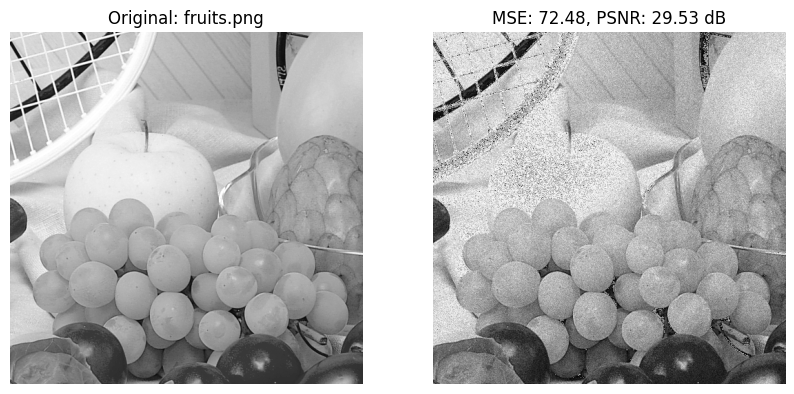

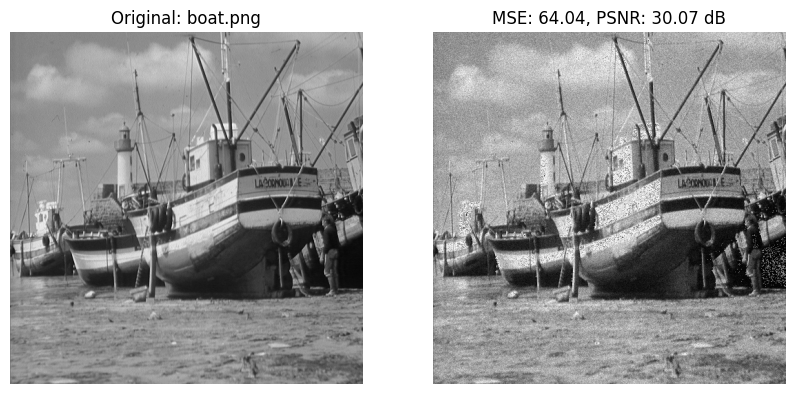

avarage mse = 85.48521804424907
avarage psnr = 28.97880567728132


In [ ]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

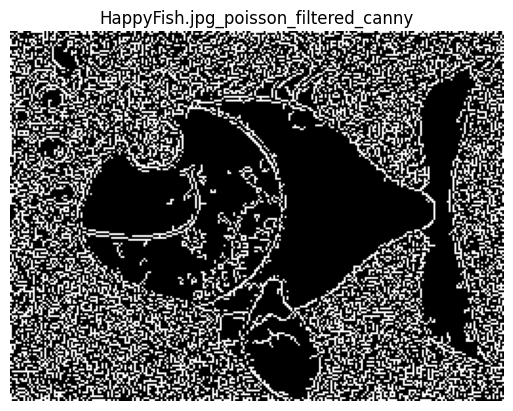

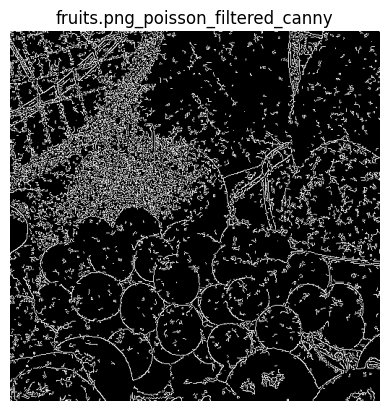

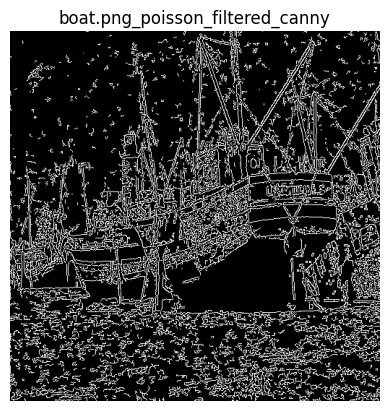

In [ ]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Even with a larger kernel, and a larger maximum kernel, the filter cannot could't reconstruct the edges that were damaged by the noise. As the filter is designed to not change edges' values, not improve them.

# Speckle Noise:

In [ ]:
def generate_speckle_noise(image_shape, mean=0, variance=0.01):
    noise = np.random.normal(mean, variance**0.5, size=image_shape)
    speckle_noise = noise * np.ones(image_shape)
    return speckle_noise

def add_speckle_noise(image, mean=0, variance=0.1):
    speckle_noise = generate_speckle_noise(image.shape, mean=mean, variance=variance)
    noisy_image = image + image * speckle_noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    return noisy_image

speckle_variances = [0.001, 0.003, 0.005]

noisy_data_speckle = []

for index, row in original.iterrows():
    for var in speckle_variances:
        noisy_img = add_speckle_noise(row['image'], variance=var)
        noisy_data_speckle.append({
            'filename': f"{row['filename']}_speckle_{var}",
            'image': noisy_img,
            'variance': var
        })

speckle_noise = pd.DataFrame(noisy_data_speckle)

In [ ]:
Computational_times["Speckle"] = []
average_MSE["Speckle"] = []
average_psnr["Speckle"] = []

In [ ]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = adaptive_mean_filter(row['image'], kernel_size=5, max_kernel_size=7)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 0.9296 seconds


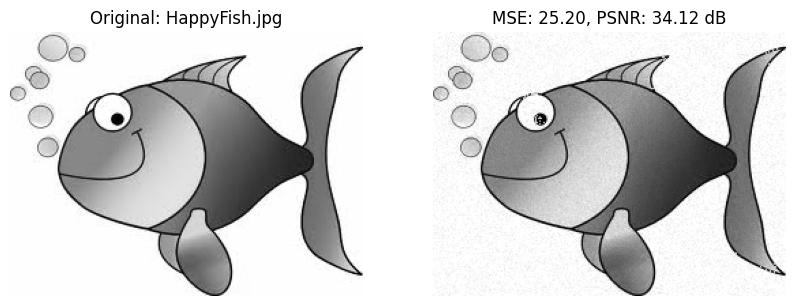

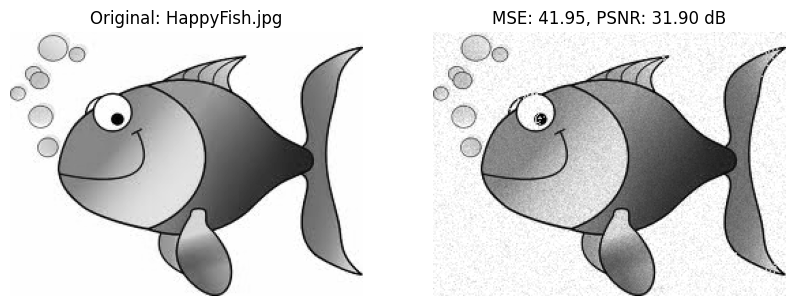

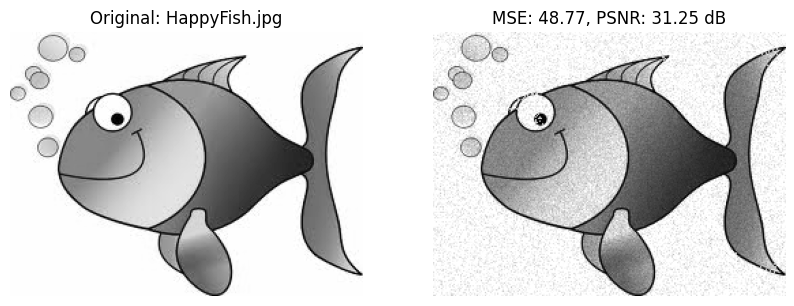

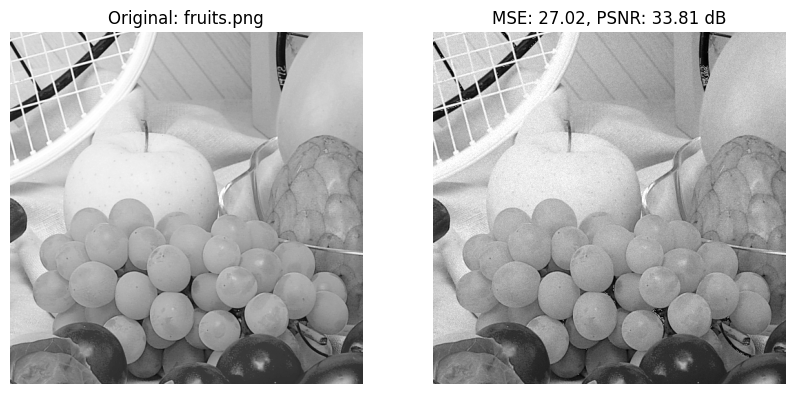

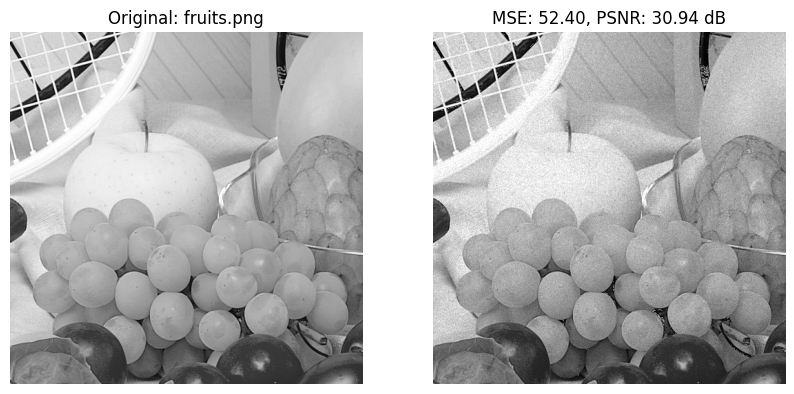

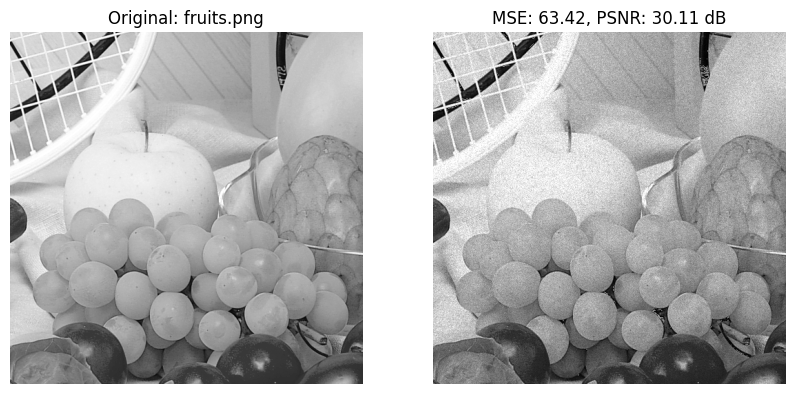

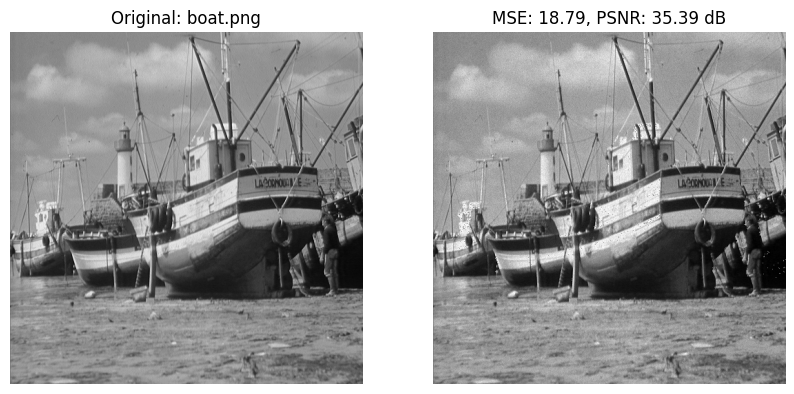

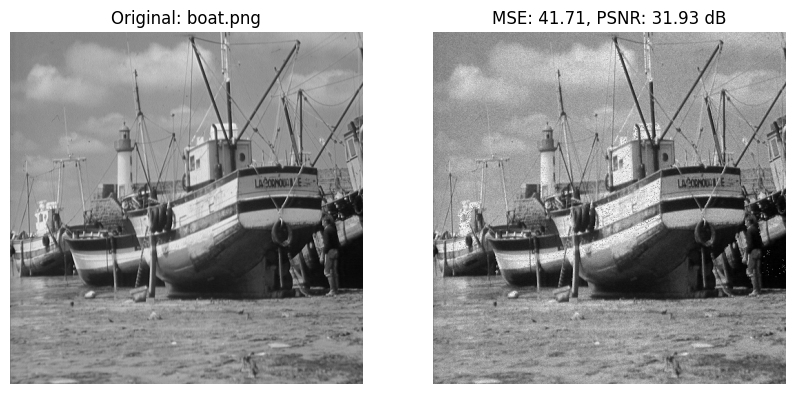

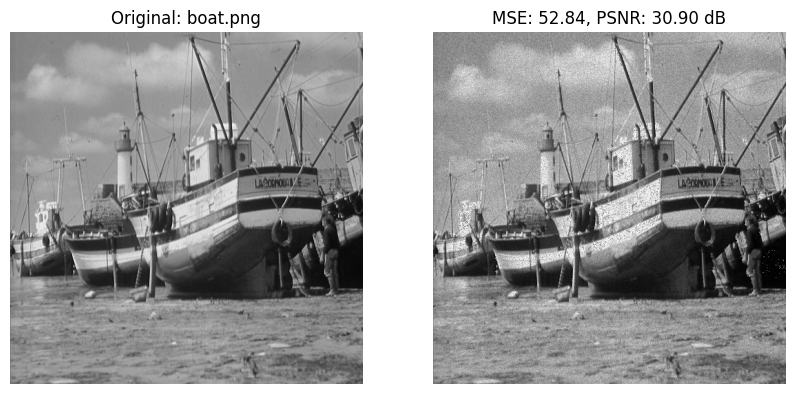

avarage mse = 41.344790473791576
avarage psnr = 32.26120851801835


In [ ]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

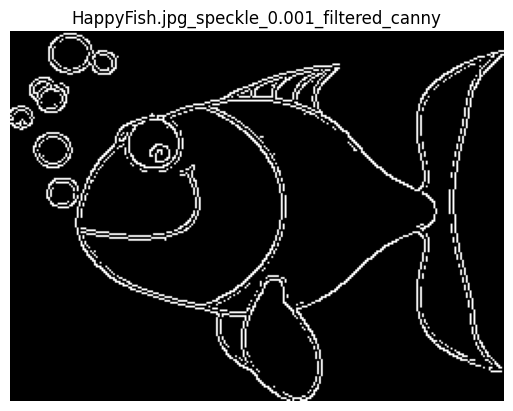

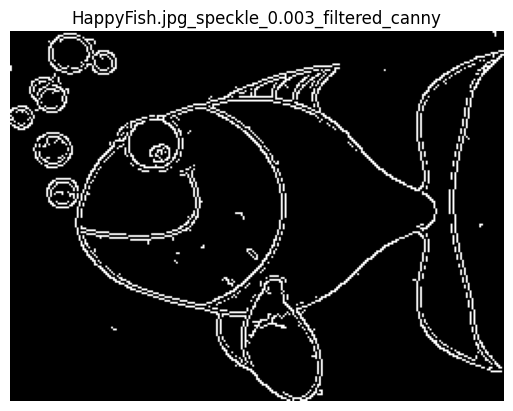

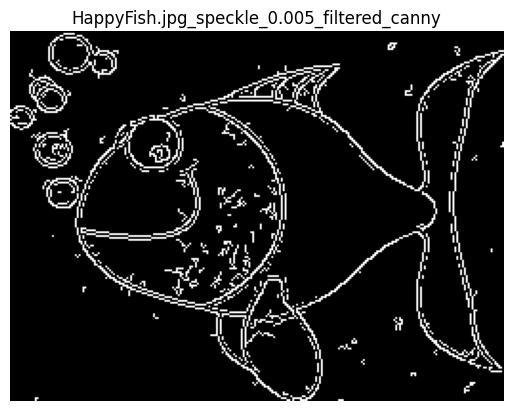

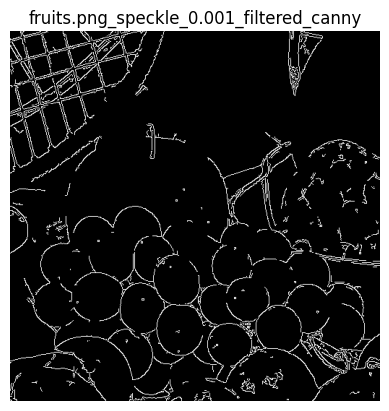

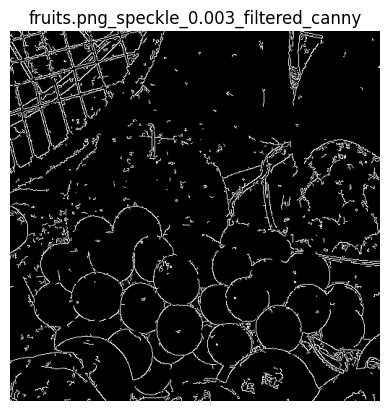

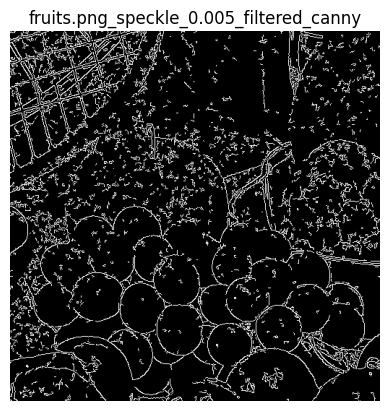

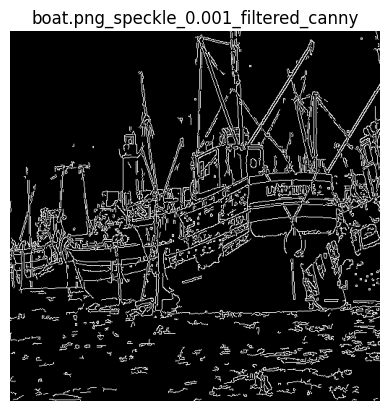

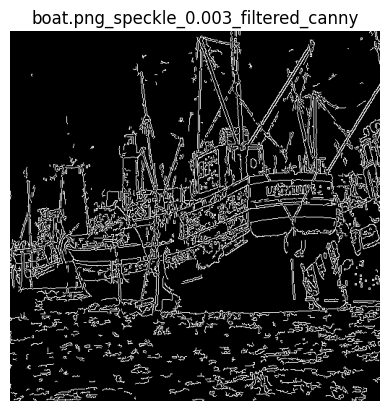

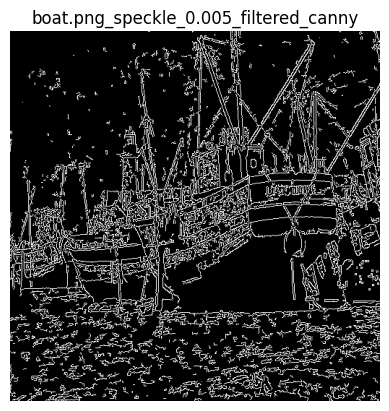

In [ ]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

It's interesting that the filter did much better in filtering speckle noise than any other type of noise, but that maybe because of the nature of the noise, as it gets distributed throughout the image, allowing the majority of the pixels inside the filter kernel to be of intact pixels, and the calculated mean closer to them.

In [ ]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = adaptive_mean_filter(row['image'], kernel_size=11, max_kernel_size=15)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 3.5704 seconds


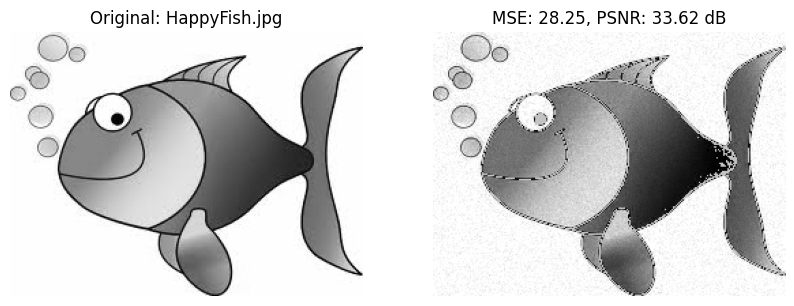

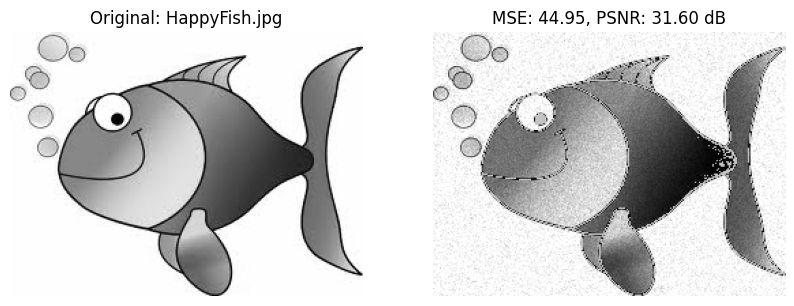

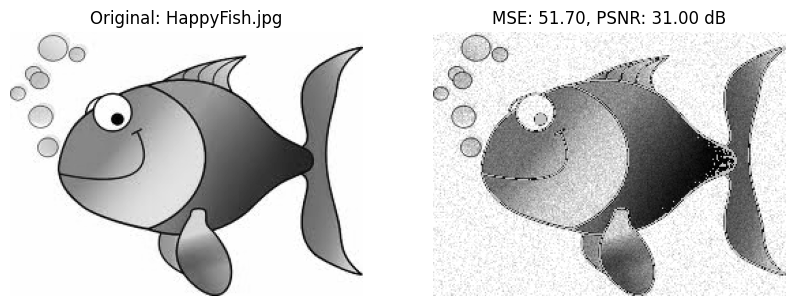

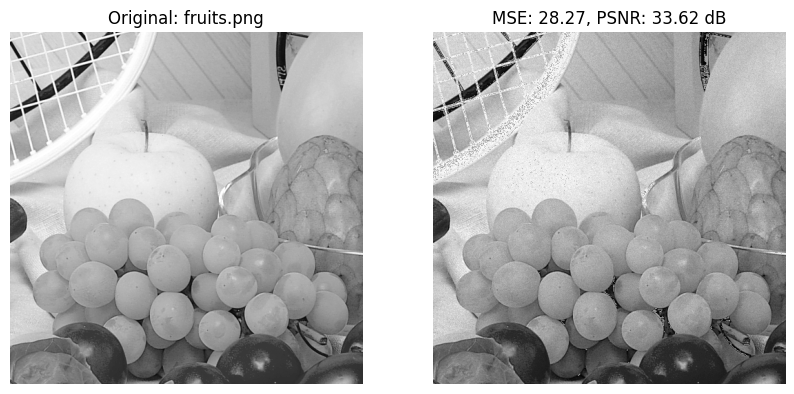

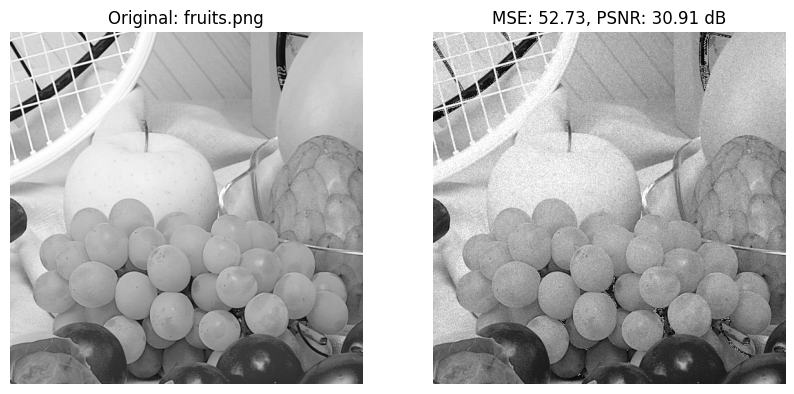

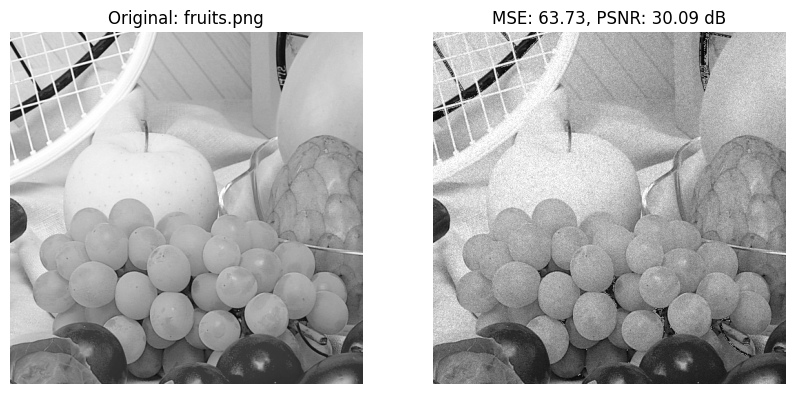

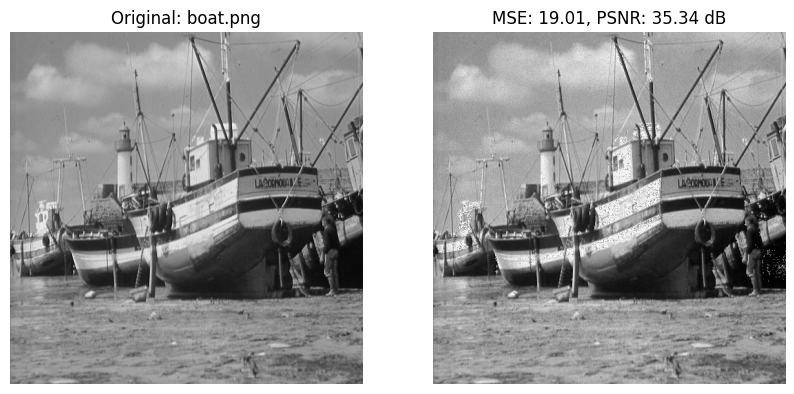

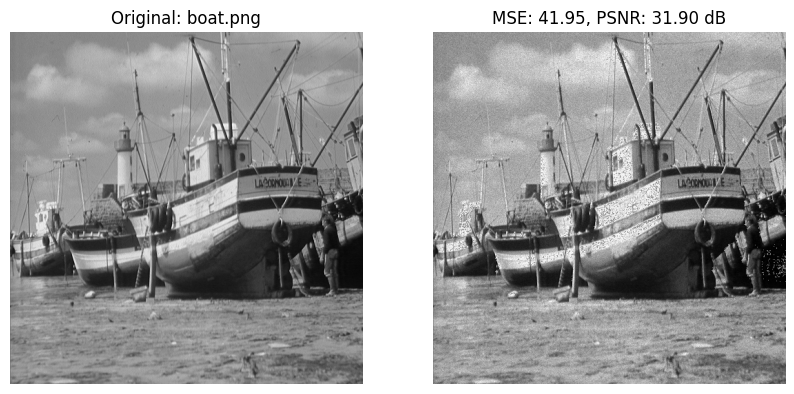

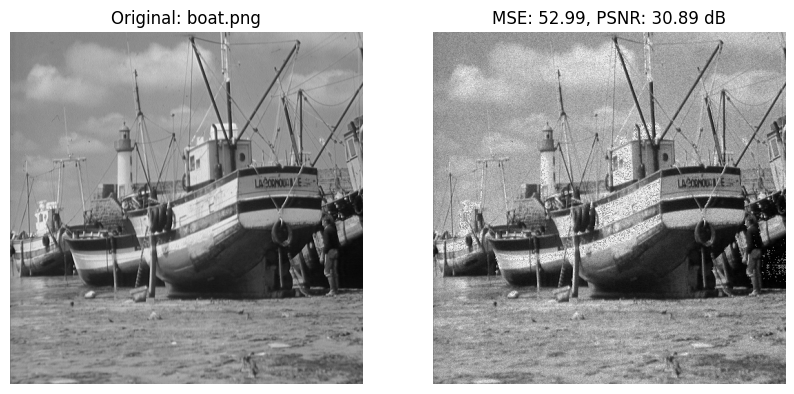

avarage mse = 42.619643582004
avarage psnr = 32.10761321939697


In [ ]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

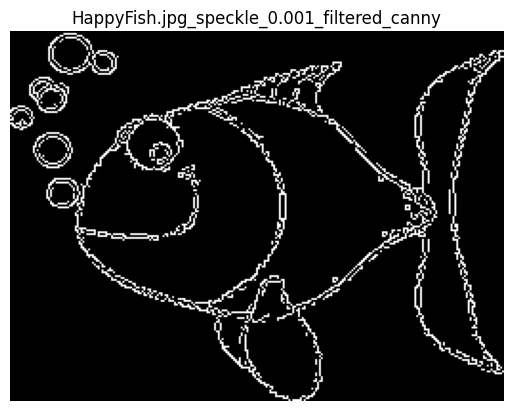

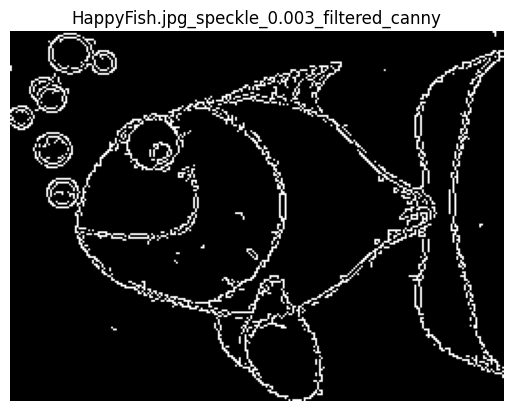

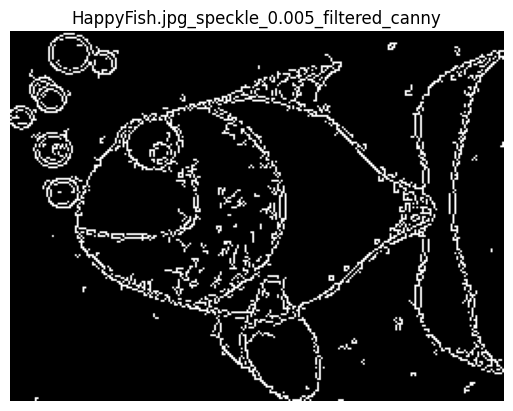

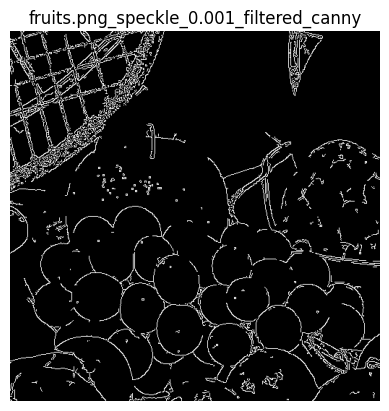

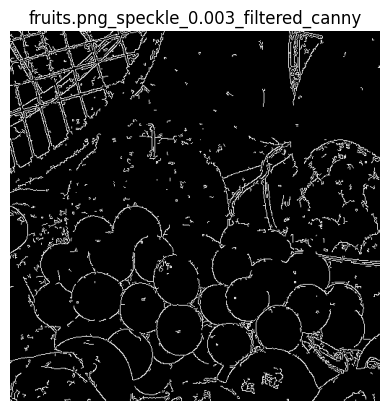

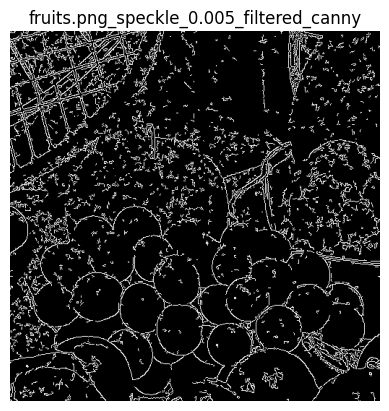

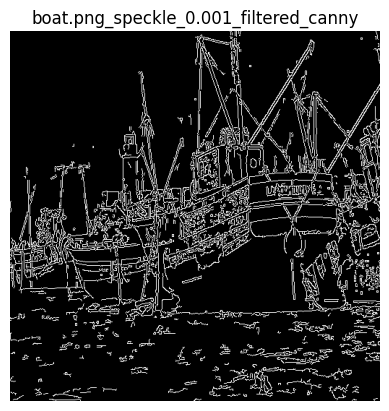

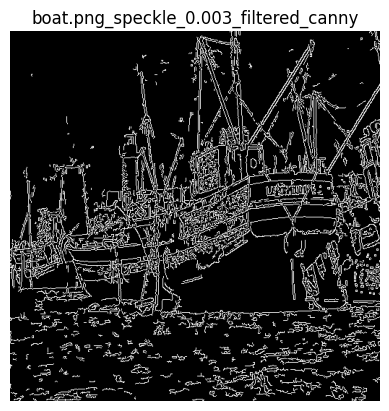

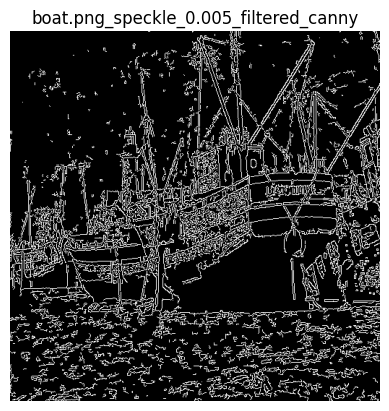

In [ ]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

With a larger kernel, the filter was able to remove more noise, as Canny detected less noise as edges than before.

# Results:

In [ ]:
comp_times_df = pd.DataFrame(Computational_times, index=['kernel=5, max=7', 'kernel=11, max=15']).T
mse_df = pd.DataFrame(average_MSE, index=['kernel=5, max=7', 'kernel=11, max=15']).T
psnr_df = pd.DataFrame(average_psnr, index=['kernel=5, max=7', 'kernel=11, max=15']).T

In [ ]:
print("Computational Times:")
comp_times_df.style.set_caption("Computational Times").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Computational Times:


,"kernel=5, max=7","kernel=11, max=15"
Salt and Pepper,0.848336,3.236774
Gaussian,1.128197,3.645362
Poisson,0.398329,1.183557
Speckle,0.929633,3.570402


As could be predicted, the computational time for a larger initial kernel and maximum kernel size is longer than the double of the computational time with a smaller kernel/maximum kernel size. That's because with a larger initial kernel size the calculation needed, of finding the maximum and minimum values in the kernel, and calculating the mean, and so on will take longer to be done.




And with a larger maximum kernel size, the filter could do more iterations until it finds the best replacement for the pixel, redoing its calculations each time.

In [ ]:
print("Average MSEs:")
mse_df.style.set_caption("Average MSEs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average MSEs:


,"kernel=5, max=7","kernel=11, max=15"
Salt and Pepper,8.721477,12.468461
Gaussian,87.806659,87.930617
Poisson,71.028615,85.485218
Speckle,41.344790,42.619644


The adaptive mean filter performs better on salt and pepper noise, as it's built on the mean filter that works well against outliers, which is the nature of salt and pepper noise.




Another thing to notice is that the filter average MSEs got worse with a larger kernel/maximum kernel size. That may be because with a larger kernel size finer details could be mistaken for noise, as they have weaker values.

In [ ]:
print("Average PSNRs:")
psnr_df.style.set_caption("Average PSNRs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average PSNRs:


,"kernel=5, max=7","kernel=11, max=15"
Salt and Pepper,40.989460,38.804351
Gaussian,28.920823,28.910821
Poisson,29.631368,28.978806
Speckle,32.261209,32.107613


The average PSNRs didn't change much with the change of kernel sizes, as in both cases the filter still works around the edges, and tries as much as possible to preserve them, which leads to the preservation of images' details.